In [ ]:
!pip install --upgrade gupload

from pydrive.auth import GoogleAuth
from google.colab import auth

     |████████████████████████████████| 81 kB 5.3 MB/s 
     |████████████████████████████████| 56 kB 4.8 MB/s 
  Attempting uninstall: google-api-python-client
    Found existing installation: google-api-python-client 1.12.10
    Uninstalling google-api-python-client-1.12.10:
      Successfully uninstalled google-api-python-client-1.12.10
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
earthengine-api 0.1.298 requires google-api-python-client<2,>=1.12.1, but you have google-api-python-client 1.7.10 which is incompatible.


In [ ]:
# Authenticate and create the PyDrive client.
auth.authenticate_user()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/AIMLProject3/yolov3

/content/drive/MyDrive/AIMLProject3/yolov3


In [ ]:
!git clone https://github.com/AlexeyAB/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 15386, done.
remote: Total 15386 (delta 0), reused 0 (delta 0), pack-reused 15386
Receiving objects: 100% (15386/15386), 14.01 MiB | 5.57 MiB/s, done.
Resolving deltas: 100% (10345/10345), done.
Checking out files: 100% (2050/2050), done.


In [ ]:
# change makefile to have GPU and OPENCV enabled
# also set CUDNN, CUDNN_HALF and LIBSO to 1

%cd darknet/
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile
!sed -i 's/LIBSO=0/LIBSO=1/' Makefile

/content/drive/MyDrive/AIMLProject3/yolov3/darknet


In [ ]:
# verify CUDA
!/usr/local/cuda/bin/nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


In [ ]:
# build darknet 
!make

chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -DCUDNN_HALF -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -DCUDNN_HALF -fPIC -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1147:13: warning: this ‘if’ clause does not guard... [-Wmisleading-indentation]
             if (iteration_old == 0)
             ^~
./src/image_

In [ ]:
!pwd

/content/drive/My Drive/AIMLProject3/yolov3/darknet


In [ ]:
# Clean the data and cfg folders first except the labels folder in data which is required

%cd data/
!find -maxdepth 1 -type f -exec rm -rf {} \;
%cd ..

%rm -rf cfg/
%mkdir cfg

/content/drive/My Drive/AIMLProject3/yolov3/darknet/data
/content/drive/My Drive/AIMLProject3/yolov3/darknet


In [ ]:
# Copy the yolov4-custom.cfg file so that it is now in /darknet/cfg/ folder 

!cp /content/drive/MyDrive/AIMLProject3/yolov3/yolov3-tiny-bdd100k.cfg  cfg

# verify if your custom file is in cfg folder
!ls cfg/

yolov3-tiny-bdd100k.cfg


In [ ]:
!ls cfg/

darknet53.conv.74  yolov3.cfg  yolov3-tiny-bdd100k.cfg


In [ ]:
# Copy the bdd100k.names and bdd100k.data files from your drive so that they are now in /darknet/data/ folder 

!cp /content/drive/MyDrive/AIMLProject3/yolov3/bdd100k.names data
!cp /content/drive/MyDrive/AIMLProject3/yolov3/bdd100k.data data

# verify if the above files are in data folder
!ls data/

bdd100k.data  bdd100k.names  labels


In [ ]:
# verify if the above files are in data folder
!ls data/

bdd100k.data   labels  train	      train.txt  val.txt
bdd100k.names  test    train_old.txt  val


In [ ]:
!pwd

/content/drive/My Drive/AIMLProject3/yolov3/darknet


In [ ]:
!ln -s /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data

In [ ]:
!ln -s /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/val /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data

In [ ]:
!ln -s /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data

In [ ]:
!cp /content/drive/MyDrive/AIMLProject3/yolov3/darknet53.conv.74 /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg

In [ ]:
!cp /content/drive/MyDrive/AIMLProject3/train.txt /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data
!cp /content/drive/MyDrive/AIMLProject3/val.txt /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data

In [ ]:
# train your custom detector! (uncomment %%capture below if you run into memory issues or your Colab is crashing)
# %%capture

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74 -dont_show -map

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 Prepare additional network for mAP calculation...
 0 : compute_capability = 370, cudnn_half = 0, GPU: Tesla K80 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max          

#### 2nd time run after removing the unloaded images

In [ ]:
# train your custom detector! (uncomment %%capture below if you run into memory issues or your Colab is crashing)
# %%capture

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74 -dont_show -map

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.313704), count: 41, class_loss = 14.124459, iou_loss = 12.364032, total_loss = 26.488491 
 total_bbox = 920566, rewritten_bbox = 15.567923 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.536980), count: 6, class_loss = 2.647170, iou_loss = 1.516829, total_loss = 4.163999 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.394921), count: 48, class_loss = 12.834791, iou_loss = 10.601995, total_loss = 23.436787 
 total_bbox = 920620, rewritten_bbox = 15.567661 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.501727), count: 9, class_loss = 3.065157, iou_loss = 2.484159, total_loss = 5.549316 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.345793), count: 74, class_loss = 18.197058, iou_loss = 18.147306, total_loss = 36.3

In [ ]:
#to restart training your custom detector where you left off(using the weights that were saved last)
#!./darknet detector train data/obj.data cfg/yolov4-custom.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights -dont_show -map

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights -dont_show -map

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.329444), count: 63, class_loss = 14.624353, iou_loss = 25.821070, total_loss = 40.445423 
 total_bbox = 190811, rewritten_bbox = 14.051600 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.620845), count: 13, class_loss = 5.051010, iou_loss = 2.210026, total_loss = 7.261035 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.396426), count: 31, class_loss = 9.854677, iou_loss = 6.874512, total_loss = 16.729189 
 total_bbox = 190855, rewritten_bbox = 14.048362 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.612132), count: 6, class_loss = 2.732472, iou_loss = 0.972424, total_loss = 3.704896 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.308630), count: 74, class_loss = 16.727957, iou_loss = 18.739370, total_loss = 35.46

### Another Train run using Colab Pro

In [ ]:
# This is another run from Colab Pro

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights -dont_show -map

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.352945), count: 65, class_loss = 9.131879, iou_loss = 15.132630, total_loss = 24.264509 
 total_bbox = 15495886, rewritten_bbox = 15.412690 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.707491), count: 8, class_loss = 2.440816, iou_loss = 0.715244, total_loss = 3.156060 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.419712), count: 63, class_loss = 8.965067, iou_loss = 10.280109, total_loss = 19.245176 
 total_bbox = 15495957, rewritten_bbox = 15.412704 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.726017), count: 8, class_loss = 0.988535, iou_loss = 0.638164, total_loss = 1.626699 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.365732), count: 64, class_loss = 12.034845, iou_loss = 12.721325, total_loss = 24

### With the generated weights after training , testing using BDD100K TEST images

### Testing

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

#### Starting the TRAINING again for displaying the CHART to understand the performance 

In [ ]:
# change line batch to batch=64
# change line subdivisions to subdivisions=16
# You can do it either manually or by simply running the code below

#set your custom cfg to test mode 
%cd cfg
!sed -i 's/batch=1/batch=64/' yolov3-tiny-bdd100k.cfg
!sed -i 's/subdivisions=1/subdivisions=16/' yolov3-tiny-bdd100k.cfg
%cd ..

/content/drive/My Drive/AIMLProject3/yolov3/darknet/cfg
/content/drive/My Drive/AIMLProject3/yolov3/darknet


In [ ]:
## training from scratch 
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74 -dont_show -map


Streaming output truncated to the last 5000 lines.
 total_bbox = 57224885, rewritten_bbox = 15.364079 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.726726), count: 13, class_loss = 1.913158, iou_loss = 0.870932, total_loss = 2.784090 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.486418), count: 47, class_loss = 6.470804, iou_loss = 5.652186, total_loss = 12.122990 
 total_bbox = 57224945, rewritten_bbox = 15.364069 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.754904), count: 14, class_loss = 2.433217, iou_loss = 1.100769, total_loss = 3.533986 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.477510), count: 61, class_loss = 11.429426, iou_loss = 8.107864, total_loss = 19.537291 
 total_bbox = 57225020, rewritten_bbox = 15.364058 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.656189), count: 13, class_

In [ ]:
# define helper function imShow
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(15, 15)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

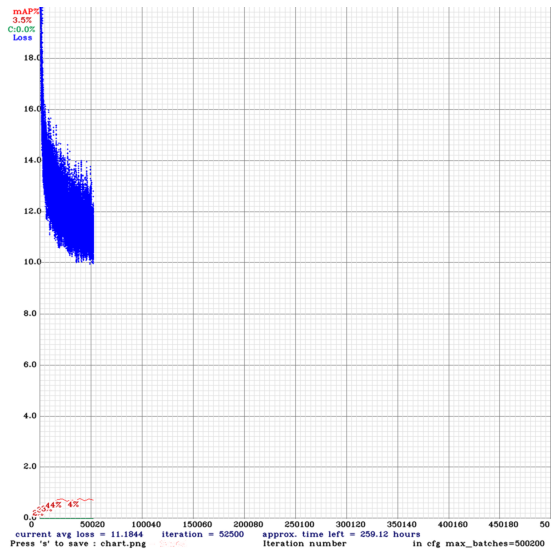

In [ ]:
#only works if the training does not get interrupted
imShow('chart.png')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

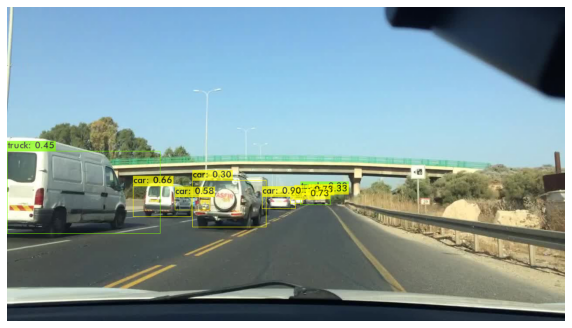

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg  /mydrive/yolov4/training/yolov4-custom_best.weights /content/cabc30fc-eb673c5a.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

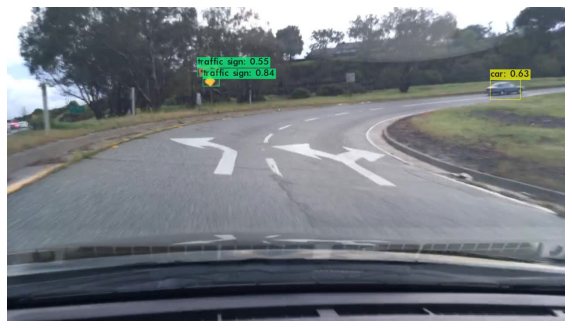

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights
imShow('predictions.jpg')

#### Starting training again from best weights

In [ ]:
# This is another run from best weights
# This run is without parameters If error occurs - run training with flag: -dont_show 
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights 


 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
yolov3-tiny-bdd100k
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 4, batch = 64, time_steps = 1, train = 1 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52

In [ ]:
# This is another run from best weights

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights -dont_show -map


Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.680452), count: 9, class_loss = 1.816966, iou_loss = 1.226295, total_loss = 3.043261 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.380743), count: 72, class_loss = 12.243795, iou_loss = 9.388508, total_loss = 21.632303 
 total_bbox = 6612620, rewritten_bbox = 15.024408 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.711263), count: 8, class_loss = 1.527592, iou_loss = 1.009274, total_loss = 2.536867 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 23 Avg (IOU: 0.473056), count: 63, class_loss = 8.817469, iou_loss = 12.188162, total_loss = 21.005630 
 total_bbox = 6612691, rewritten_bbox = 15.024368 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 16 Avg (IOU: 0.654890), count: 11, class_loss = 1.781453, iou_loss = 1.044751, total_loss = 2.8262

##### Calculating mAP for BDD100K dataset

In [ ]:
!./darknet detector map /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_20000.weights

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

### Testing for best map

In [ ]:
!./darknet detector map /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

### Checking map with last weights

In [ ]:
!./darknet detector map /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

### Testing our custom object detector

In [ ]:
!pwd

/content/drive/MyDrive/AIMLProject3


In [ ]:
# change line batch to batch=1
# change line subdivisions to subdivisions=1
# You can do it either manually or by simply running the code below

#set your custom cfg to test mode 
%cd cfg
!sed -i 's/batch=64/batch=1/' yolov3-tiny-bdd100k.cfg
!sed -i 's/subdivisions=16/subdivisions=1/' yolov3-tiny-bdd100k.cfg
%cd ..

/content/drive/My Drive/AIMLProject3/yolov3/darknet/cfg
/content/drive/My Drive/AIMLProject3/yolov3/darknet


In [ ]:
%cd /content/drive/MyDrive/AIMLProject3/yolov3/darknet

/content/drive/MyDrive/AIMLProject3/yolov3/darknet


In [ ]:
!pwd

/content/drive/MyDrive/AIMLProject3/yolov3/darknet


In [ ]:
# change line batch to batch=1
# change line subdivisions to subdivisions=1
# You can do it either manually or by simply running the code below

#set your custom cfg to test mode 
%cd cfg
!sed -i 's/batch=1/batch=64/' yolov3.cfg
!sed -i 's/subdivisions=1/subdivisions=16/' yolov3.cfg
%cd ..

/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg
/content/drive/MyDrive/AIMLProject3/yolov3/darknet


##Run detector on an image

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

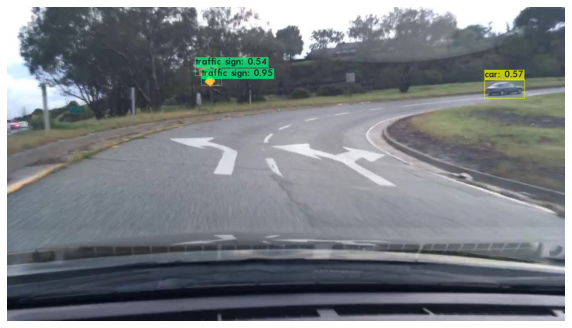

In [ ]:
# run your custom detector with this command (upload an image to your google drive to test, the thresh flag sets the minimum accuracy required for object detection)

!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/caee33ed-136d6b7c.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

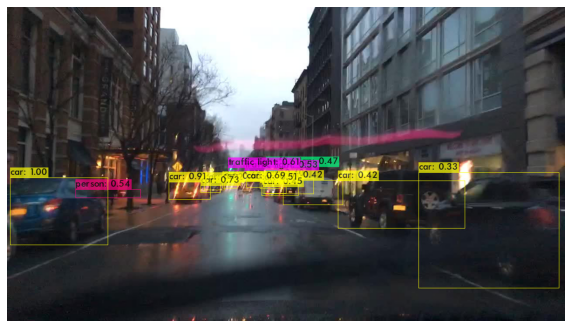

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

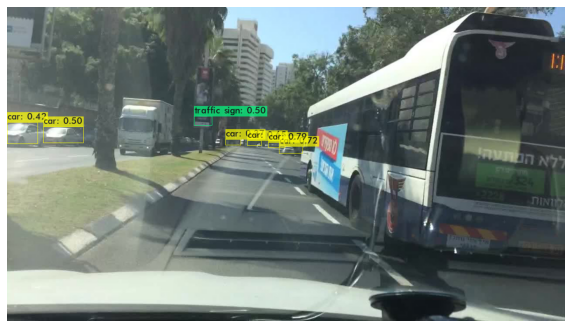

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabf9f3c-d58a6760.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26 

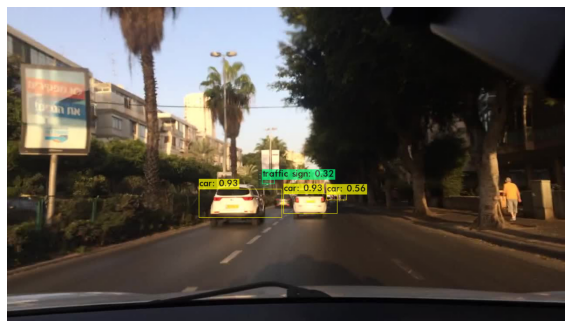

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabc30fc-e7726578.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

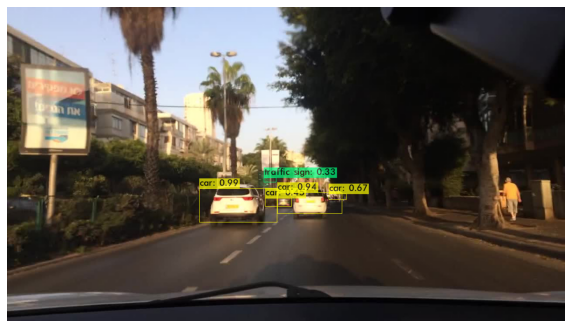

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabc30fc-e7726578.jpg -thresh 0.3 
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

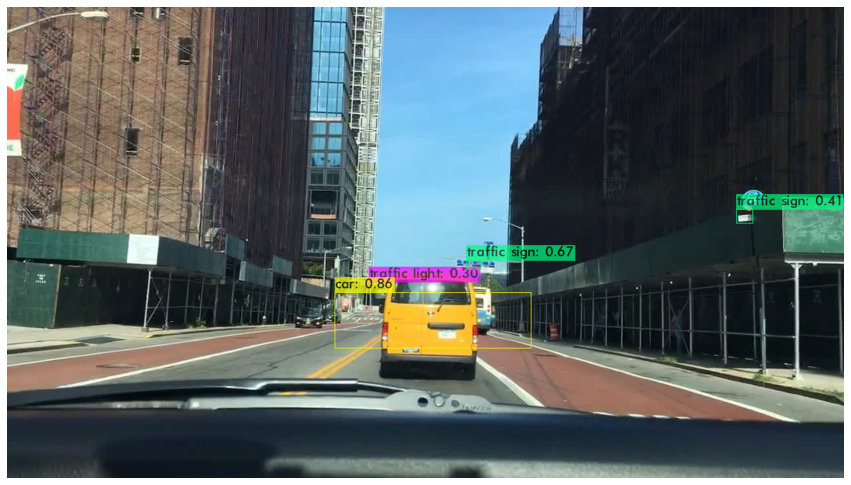

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cace2484-cd478fab.jpg -thresh 0.3 
imShow('predictions.jpg')

### Detecting the objects in the video

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights -dont_show /content/drive/MyDrive/AIMLProject3/usa-street.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_finalresult.avi 

Streaming output truncated to the last 5000 lines.
car: 94% 
car: 91% 
car: 83% 
car: 78% 
car: 62% 
car: 32% 

FPS:58.2 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

truck: 34% 
person: 64% 
car: 94% 
car: 91% 
car: 81% 
car: 79% 
car: 63% 
car: 41% 
car: 33% 

FPS:58.2 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

truck: 31% 
person: 76% 
car: 94% 
car: 89% 
car: 82% 
car: 80% 
car: 76% 
car: 33% 
car: 32% 

FPS:55.9 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

truck: 28% 
person: 59% 
person: 40% 
car: 95% 
car: 87% 
car: 87% 
car: 85% 
car: 76% 
car: 46% 
car: 33% 

FPS:54.9 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

truck: 32% 
person: 49% 
person: 33% 
car: 91% 
car: 90% 
car: 85% 
car: 82% 
car: 67% 
car: 46% 
car: 37% 

FPS:54.6 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

car: 35% , truck: 33% 
person: 50% 
person: 47% 
car: 94% 
car: 91% 
car: 87% 
car: 81% 
car: 59% 
car: 41% 

FPS:53.2 	 AVG_FPS:49.9

 cvWriteFrame 
Objects:

car: 44% , truck: 30% 
person: 55% 
person: 50% 
car: 94% 
car: 93% 

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

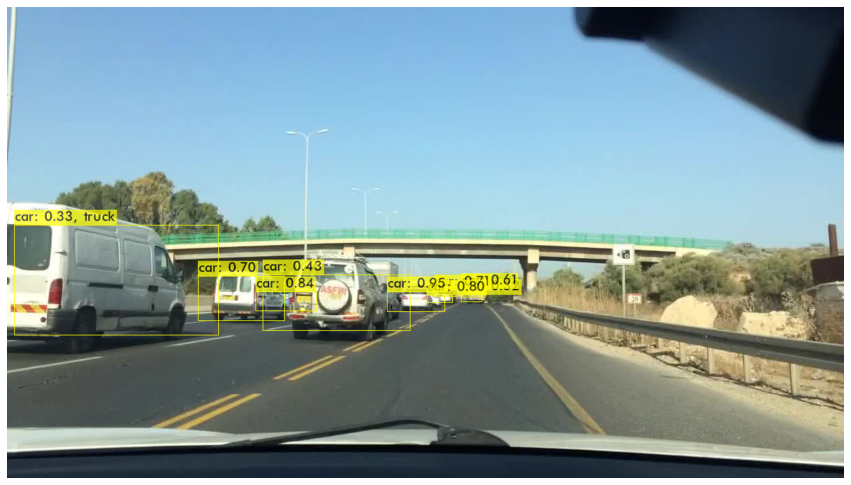

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabc30fc-eb673c5a.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     16       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  16 0.150 BF
   1 max                2x 2/ 2    416 x 416 x  16 ->  208 x 208 x  16 0.003 BF
   2 conv     32       3 x 3/ 1    208 x 208 x  16 ->  208 x 208 x  32 0.399 BF
   3 max                2x 2/ 2    208 x 208 x  32 ->  104 x 104 x  32 0.001 BF
   4 conv     64       3 x 3/ 1    104 x 104 x  32 ->  104 x 104 x  64 0.399 BF
   5 max                2x 2/ 2    104 x 104 x  64 ->   52 x  52 x  64 0.001 BF
   6 conv    128       3 x 3/ 1     52 x  52 x  64 ->   52 x  52 x 128 0.399 BF
   7 max                2x 2/ 2     52 x  52 x 128 ->   26

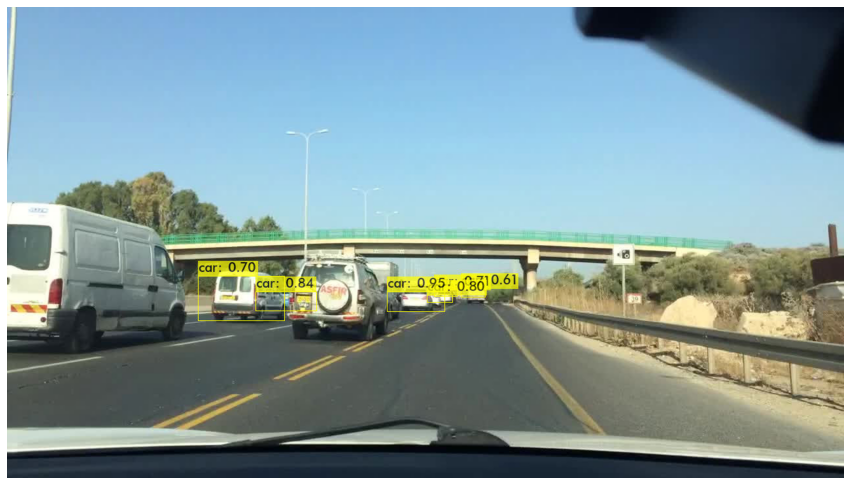

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabc30fc-eb673c5a.jpg -thresh 0.5
imShow('predictions.jpg')

## Model Deployment 
##### GRADIO Tool #####

In [ ]:
!pip install -q gradio 

     |████████████████████████████████| 871 kB 7.2 MB/s 
     |████████████████████████████████| 210 kB 60.9 MB/s 
     |████████████████████████████████| 54 kB 3.7 MB/s 
     |████████████████████████████████| 52 kB 1.1 MB/s 
     |████████████████████████████████| 2.0 MB 58.3 MB/s 
     |████████████████████████████████| 1.1 MB 62.8 MB/s 
     |████████████████████████████████| 94 kB 3.9 MB/s 
     |████████████████████████████████| 271 kB 52.2 MB/s 
     |████████████████████████████████| 144 kB 73.2 MB/s 
     |████████████████████████████████| 58 kB 7.5 MB/s 
     |████████████████████████████████| 10.9 MB 69.3 MB/s 
     |████████████████████████████████| 79 kB 9.1 MB/s 
     |████████████████████████████████| 856 kB 65.6 MB/s 
     |████████████████████████████████| 61 kB 537 kB/s 
     |████████████████████████████████| 3.6 MB 63.8 MB/s 
     |████████████████████████████████| 58 kB 7.1 MB/s 


In [ ]:
import gradio as gr
import torch
from PIL import Image

In [ ]:
model = torch.hub.load('ultralytics/yolov3', 'yolov3')  # or yolov3-spp, yolov3-tiny, custom

Using cache found in /root/.cache/torch/hub/ultralytics_yolov3_master
YOLOv3 🚀 2022-1-30 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 261 layers, 61922845 parameters, 0 gradients
Adding AutoShape... 


In [ ]:
import os
os.kill(os.getpid(), 9)

In [ ]:
exit()

In [ ]:
def yolo(im, size=640):
    g = (size / max(im.size))  # gain
    im = im.resize((int(x * g) for x in im.size), Image.ANTIALIAS)  # resize
    results = model(im)  # inference
    results.render()  # updates results.imgs with boxes and labels
    return Image.fromarray(results.imgs[0])

In [ ]:
inputs = gr.inputs.Image(type='pil', label="Original Image")
outputs = gr.outputs.Image(type="pil", label="Output Image")

In [ ]:
gr.Interface(yolo, inputs, outputs, theme="huggingface").launch(
    debug=True)

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().


Connected (version 2.0, client OpenSSH_7.6p1)
Authentication (publickey) successful!


Running on public URL: https://53802.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.


(<fastapi.applications.FastAPI at 0x7fb82e19e250>,
 'http://127.0.0.1:7860/',
 'https://53802.gradio.app')

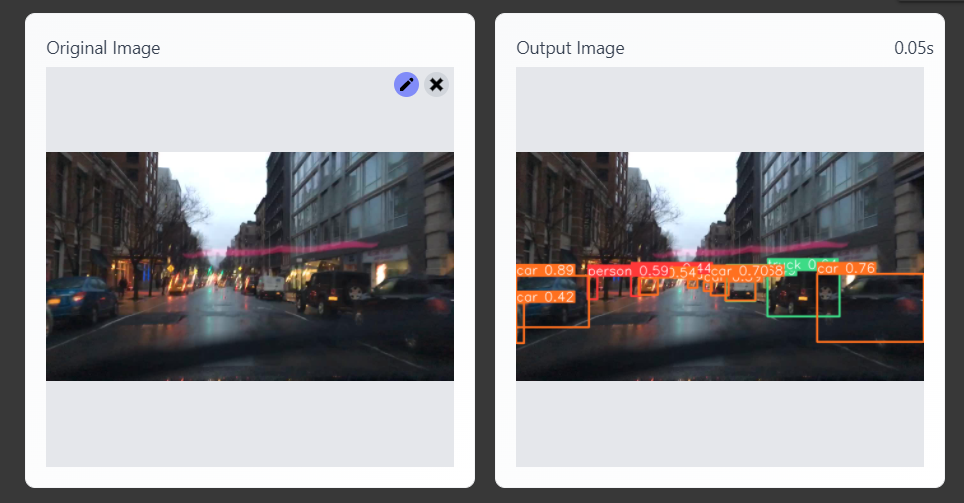

### Another Try

In [ ]:
# model_tiny = '/content/drive/MyDrive/AIMLProject3/yolov3/yolov3-tiny-bdd100k.cfg'

In [ ]:
# def yolo(im, size=640):
#     g = (size / max(im.size))  # gain
#     im = im.resize((int(x * g) for x in im.size), Image.ANTIALIAS)  # resize
#     results = model_tiny(im)  # inference
#     results.render()  # updates results.imgs with boxes and labels
#     return Image.fromarray(results.imgs[0])

In [ ]:
# inputs1 = gr.inputs.Image(type='pil', label="Original Image")
# outputs1 = gr.outputs.Image(type="pil", label="Output Image")

In [ ]:
# gr.Interface(yolo, inputs1, outputs1, theme="huggingface").launch(
#     debug=True)

In [ ]:
# #from tool import darknet2pytorch
# from tool.darknet2pytorch import Darknet
# import torch

# # load weights from darknet format
# model = darknet2pytorch.Darknet('/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg', inference=True)
# model.load_weights('/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights')

# # save weights to pytorch format
# torch.save(model.state_dict(), '/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k-pytorch.pth')

# # reload weights from pytorch format
# model_pt = darknet2pytorch.Darknet('/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg', inference=True)
# model_pt.load_state_dict(torch.load('/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k-pytorch.pth'))

In [ ]:
import cv2 as cv
import numpy as np

In [ ]:
net = cv.dnn.readNetFromDarknet('/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg', '/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights')
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)

In [ ]:
ln = net.getLayerNames()
print(len(ln), ln)

48 ['conv_0', 'bn_0', 'relu_0', 'pool_1', 'conv_2', 'bn_2', 'relu_2', 'pool_3', 'conv_4', 'bn_4', 'relu_4', 'pool_5', 'conv_6', 'bn_6', 'relu_6', 'pool_7', 'conv_8', 'bn_8', 'relu_8', 'pool_9', 'conv_10', 'bn_10', 'relu_10', 'pool_11', 'conv_12', 'bn_12', 'relu_12', 'conv_13', 'bn_13', 'relu_13', 'conv_14', 'bn_14', 'relu_14', 'conv_15', 'permute_16', 'yolo_16', 'identity_17', 'conv_18', 'bn_18', 'relu_18', 'upsample_19', 'concat_20', 'conv_21', 'bn_21', 'relu_21', 'conv_22', 'permute_23', 'yolo_23']


In [ ]:
import numpy as np
import pandas as pd
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 
import matplotlib.pylab as plt

In [ ]:
# YOLO object detection
import cv2 as cv
import numpy as np
import time

WHITE = (255, 255, 255)
img = None
img0 = None
outputs = None

# Load names of classes and get random colors
classes = open('/content/drive/MyDrive/AIMLProject3/yolov3/bdd100k.names').read().strip().split('\n')
np.random.seed(42)
colors = np.random.randint(0, 255, size=(len(classes), 3), dtype='uint8')

# Give the configuration and weight files for the model and load the network.
net = cv.dnn.readNetFromDarknet('/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg', '/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights')
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
# net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU)

# determine the output layer
ln = net.getLayerNames()
ln = [ln[i[0] - 1] for i in net.getUnconnectedOutLayers()]


In [ ]:
def load_image(path):
    global img, img0, outputs, ln

    img0 = cv.imread(path)
    img = img0.copy()
    
    blob = cv.dnn.blobFromImage(img, 1/255.0, (416, 416), swapRB=True, crop=False)

    net.setInput(blob)
    t0 = time.time()
    outputs = net.forward(ln)
    t = time.time() - t0

    # combine the 3 output groups into 1 (10647, 85)
    # large objects (507, 85)
    # medium objects (2028, 85)
    # small objects (8112, 85)
    outputs = np.vstack(outputs)

    post_process(img, outputs, 0.5)
    #cv.imshow('window',  img)
    plt.imshow(img)
    #cv.displayOverlay('window', f'forward propagation time={t:.3}')
    cv.waitKey(0)

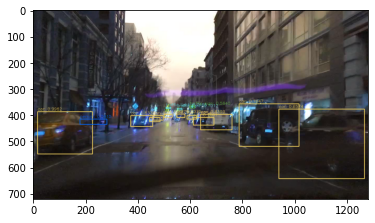

In [ ]:
load_image('/content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg')

In [ ]:
def post_process(img, outputs, conf):
    H, W = img.shape[:2]

    boxes = []
    confidences = []
    classIDs = []

    for output in outputs:
        scores = output[5:]
        classID = np.argmax(scores)
        confidence = scores[classID]
        if confidence > conf:
            x, y, w, h = output[:4] * np.array([W, H, W, H])
            p0 = int(x - w//2), int(y - h//2)
            p1 = int(x + w//2), int(y + h//2)
            boxes.append([*p0, int(w), int(h)])
            confidences.append(float(confidence))
            classIDs.append(classID)
            # cv.rectangle(img, p0, p1, WHITE, 1)

    indices = cv.dnn.NMSBoxes(boxes, confidences, conf, conf-0.1)
    if len(indices) > 0:
        for i in indices.flatten():
            (x, y) = (boxes[i][0], boxes[i][1])
            (w, h) = (boxes[i][2], boxes[i][3])
            color = [int(c) for c in colors[classIDs[i]]]
            cv.rectangle(img, (x, y), (x + w, y + h), color, 2)
            text = "{}: {:.4f}".format(classes[classIDs[i]], confidences[i])
            cv.putText(img, text, (x, y - 5), cv.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

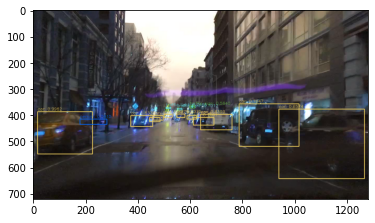

In [ ]:
load_image('/content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg')

In [ ]:
#conf = x/100
img = '/content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg'
#img = img0.copy()
post_process(img, outputs, 0.5)
#cv.displayOverlay('window', f'confidence level={conf}')
#cv.imshow('window', img)
plt.imshow(img)

AttributeError: ignored

In [ ]:
# YOLO object detection
import cv2 as cv
import numpy as np
import time

WHITE = (255, 255, 255)
img = None
img0 = None
outputs = None

# Load names of classes and get random colors
classes = open('/content/drive/MyDrive/AIMLProject3/yolov3/bdd100k.names').read().strip().split('\n')
np.random.seed(42)
colors = np.random.randint(0, 255, size=(len(classes), 3), dtype='uint8')

# Give the configuration and weight files for the model and load the network.
net = cv.dnn.readNetFromDarknet('/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3-tiny-bdd100k.cfg', '/content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3-tiny-bdd100k_last.weights')
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
# net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU)

# determine the output layer
ln = net.getLayerNames()
ln = [ln[i[0] - 1] for i in net.getUnconnectedOutLayers()]

def load_image(path):
    global img, img0, outputs, ln

    img0 = cv.imread(path)
    img = img0.copy()
    
    blob = cv.dnn.blobFromImage(img, 1/255.0, (416, 416), swapRB=True, crop=False)

    net.setInput(blob)
    t0 = time.time()
    outputs = net.forward(ln)
    t = time.time() - t0

    # combine the 3 output groups into 1 (10647, 85)
    # large objects (507, 85)
    # medium objects (2028, 85)
    # small objects (8112, 85)
    outputs = np.vstack(outputs)

    post_process(img, outputs, 0.5)
    #cv.imshow('window',  img)
    plt.imshow(img)
    #cv.displayOverlay('window', f'forward propagation time={t:.3}')
    cv.waitKey(0)

def post_process(img, outputs, conf):
    H, W = img.shape[:2]

    boxes = []
    confidences = []
    classIDs = []

    for output in outputs:
        scores = output[5:]
        classID = np.argmax(scores)
        confidence = scores[classID]
        if confidence > conf:
            x, y, w, h = output[:4] * np.array([W, H, W, H])
            p0 = int(x - w//2), int(y - h//2)
            p1 = int(x + w//2), int(y + h//2)
            boxes.append([*p0, int(w), int(h)])
            confidences.append(float(confidence))
            classIDs.append(classID)
            # cv.rectangle(img, p0, p1, WHITE, 1)

    indices = cv.dnn.NMSBoxes(boxes, confidences, conf, conf-0.1)
    if len(indices) > 0:
        for i in indices.flatten():
            (x, y) = (boxes[i][0], boxes[i][1])
            (w, h) = (boxes[i][2], boxes[i][3])
            color = [int(c) for c in colors[classIDs[i]]]
            cv.rectangle(img, (x, y), (x + w, y + h), color, 2)
            text = "{}: {:.4f}".format(classes[classIDs[i]], confidences[i])
            cv.putText(img, text, (x, y - 5), cv.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

def trackbar(x):
    global img
    conf = x/100
    img = img0.copy()
    post_process(img, outputs, conf)
    #cv.displayOverlay('window', f'confidence level={conf}')
    plt.imshow('window', img)
    plt.imshow(img)

# cv.namedWindow('window')
# cv.createTrackbar('confidence', 'window', 50, 100, trackbar)
# load_image('/content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg')


# cv.destroyAllWindows()

## Performance Tuning

#### Training with new configs

In [ ]:
# train your custom detector! (uncomment %%capture below if you run into memory issues or your Colab is crashing)
# %%capture

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74  -map


 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 Prepare additional network for mAP calculation...
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   3 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   5 conv    128       3 x 3/ 2    304 x 304 x  64 ->  152 x 152 x 128 3.407 BF
   6 conv     64       1 x 1/ 1    152 x 152 x 128 ->  152 x 152 x  64 0.379 BF
   7 conv   

In [ ]:
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74  -dont_show -map

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.735979), count: 10, class_loss = 1.666697, iou_loss = 0.756015, total_loss = 2.422712 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.382070), count: 47, class_loss = 11.561556, iou_loss = 16.879107, total_loss = 28.440662 
 total_bbox = 895764, rewritten_bbox = 2.691780 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.586597), count: 2, class_loss = 0.600655, iou_loss = 0.382025, total_loss = 0.982680 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.615124), count: 12, class_loss = 1.532285, iou_loss = 1.869724, total_loss = 3.402009 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.401080), count: 120, class_loss = 28.296785, iou_loss = 36.516914, total_loss = 64.813698 
 total_bbox = 895898, rewritten_bbox = 2.6919

#### Restarted training with latest weights file 

In [ ]:
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_last.weights -dont_show -map

/bin/bash: ./darknet: No such file or directory


In [ ]:
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_last.weights -dont_show -map

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 Prepare additional network for mAP calculation...
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   3 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   5 conv    128       3 x 3/ 2    304 x 304 x  64 ->  152 x 152 x 128 3.407 BF
   6 conv     64       1 x 1/ 1    152 x 152 x 128 ->  152 x 152 x  64 0.379 BF
   7 conv   

In [ ]:
# train your custom detector! (uncomment %%capture below if you run into memory issues or your Colab is crashing)
# %%capture

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74  -map

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 Prepare additional network for mAP calculation...
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    608 x 608 x   3 ->  608 x 608 x  32 0.639 BF
   1 conv     64       3 x 3/ 2    608 x 608 x  32 ->  304 x 304 x  64 3.407 BF
   2 conv     32       1 x 1/ 1    304 x 304 x  64 ->  304 x 304 x  32 0.379 BF
   3 conv     64       3 x 3/ 1    304 x 304 x  32 ->  304 x 304 x  64 3.407 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 304 x 304 x  64 0.006 BF
   5 conv    128       3 x 3/ 2    304 x 304 x  64 ->  152 x 152 x 128 3.407 BF
   6 conv     64       1 x 1/ 1    152 x 152 x 128 ->  152 x 152 x  64 0.379 BF
   7 conv   

In [ ]:
# train your custom detector! (uncomment %%capture below if you run into memory issues or your Colab is crashing)
# %%capture

!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/darknet53.conv.74  -dont_show -map

Streaming output truncated to the last 5000 lines.
 7120: 5.867815, 6.114584 avg loss, 0.000010 rate, 9.909419 seconds, 455680 images, 26.550757 hours left
Resizing, random_coef = 1.40 

 416 x 416 
 try to allocate additional workspace_size = 67.53 MB 
 CUDA allocate done! 
Loaded: 0.000052 seconds
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.826972), count: 6, class_loss = 0.091191, iou_loss = 0.118884, total_loss = 0.210075 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.779485), count: 9, class_loss = 0.502555, iou_loss = 0.495191, total_loss = 0.997746 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.584063), count: 40, class_loss = 7.915679, iou_loss = 4.560840, total_loss = 12.476519 
 total_bbox = 7767195, rewritten_bbox = 5.288228 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.777574), count: 2, class_loss = 0.028424, iou_loss = 0.094

#### Retrain

In [ ]:
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_last.weights -dont_show -map

Streaming output truncated to the last 5000 lines.
 total_bbox = 8474244, rewritten_bbox = 5.301806 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.000000), count: 1, class_loss = 0.000098, iou_loss = 0.000000, total_loss = 0.000098 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.762546), count: 3, class_loss = 0.168270, iou_loss = 0.152171, total_loss = 0.320441 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.599469), count: 34, class_loss = 4.487885, iou_loss = 3.239415, total_loss = 7.727300 
 total_bbox = 8474281, rewritten_bbox = 5.301795 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.935081), count: 1, class_loss = 0.004579, iou_loss = 0.007359, total_loss = 0.011937 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.758086), count: 6, class_loss = 0.636011, iou_loss = 0.352765, total_loss = 0.988776 
v3 

### Retrain after 14900 iterations

In [ ]:
!./darknet detector train /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_last.weights -dont_show -map

Streaming output truncated to the last 5000 lines.
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.784033), count: 7, class_loss = 0.625988, iou_loss = 0.394316, total_loss = 1.020304 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.598334), count: 60, class_loss = 8.754992, iou_loss = 6.128715, total_loss = 14.883706 
 total_bbox = 5491260, rewritten_bbox = 5.173658 % 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 82 Avg (IOU: 0.797791), count: 6, class_loss = 0.679247, iou_loss = 0.299046, total_loss = 0.978293 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 94 Avg (IOU: 0.805158), count: 17, class_loss = 1.904795, iou_loss = 0.637980, total_loss = 2.542774 
v3 (mse loss, Normalizer: (iou: 0.75, obj: 1.00, cls: 1.00) Region 106 Avg (IOU: 0.614332), count: 65, class_loss = 9.869345, iou_loss = 6.583372, total_loss = 16.452717 
 total_bbox = 5491348, rewritten_bbox = 5.173575 %

#### Testing with yolo.cfg file

In [ ]:
# change line batch to batch=1
# change line subdivisions to subdivisions=1
# You can do it either manually or by simply running the code below

#set your custom cfg to test mode 
%cd cfg
!sed -i 's/batch=64/batch=1/' yolov3.cfg
!sed -i 's/subdivisions=16/subdivisions=1/' yolov3.cfg
%cd ..

/content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg
/content/drive/MyDrive/AIMLProject3/yolov3/darknet


In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

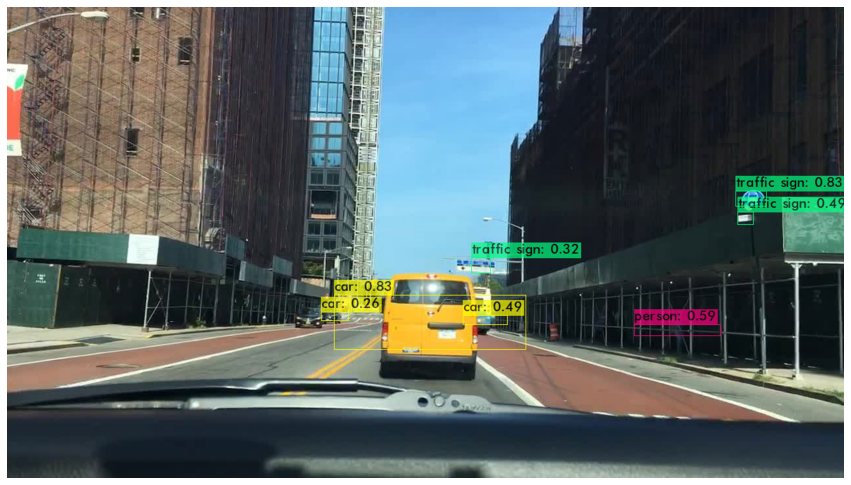

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

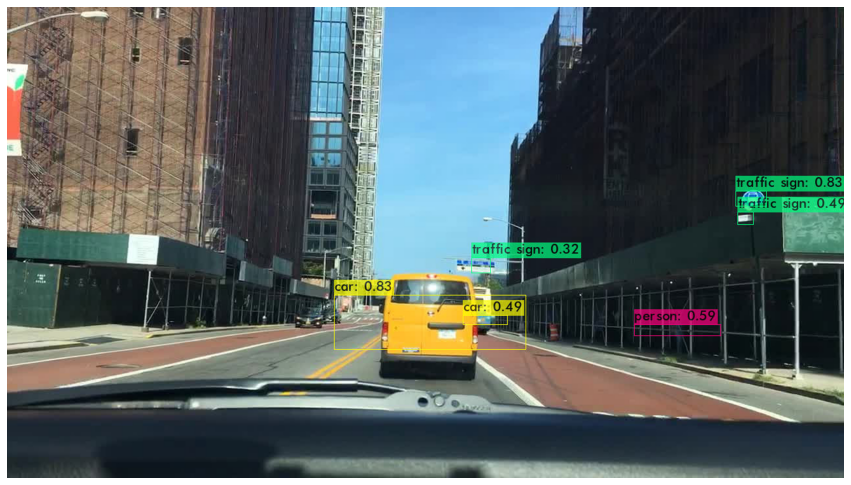

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cace2484-cd478fab.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

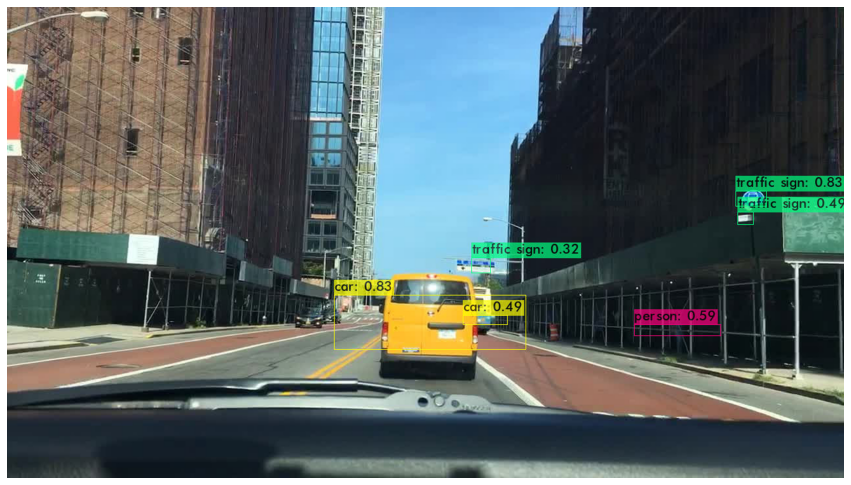

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cace2484-cd478fab.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

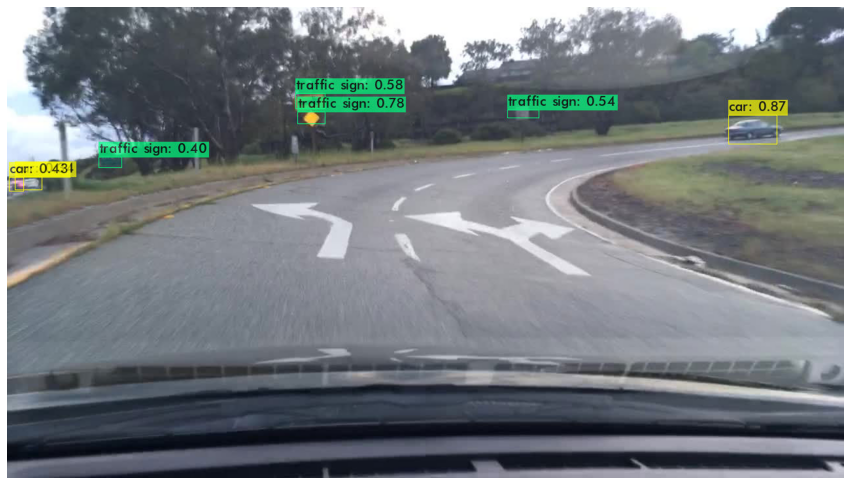

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/caee33ed-136d6b7c.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

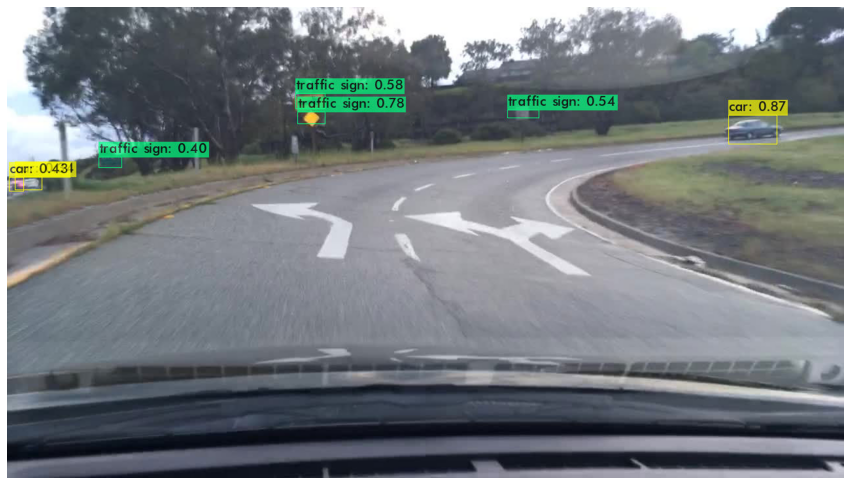

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_best.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/caee33ed-136d6b7c.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

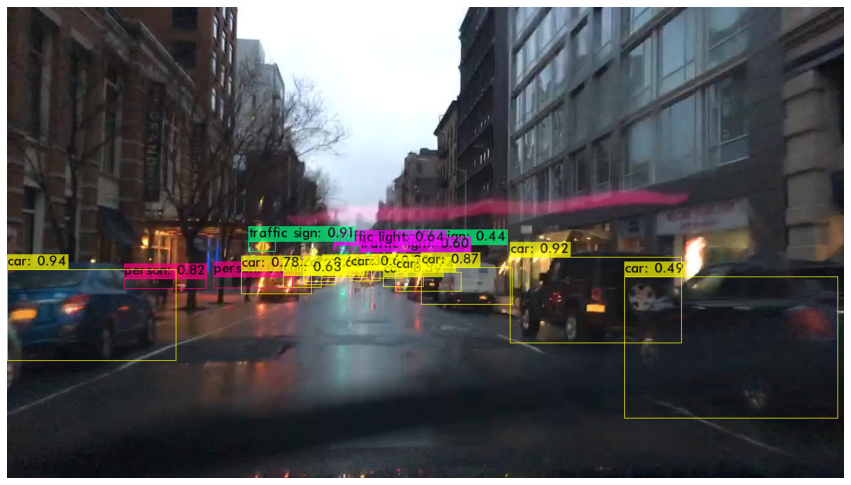

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad180c4-2edc9315.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

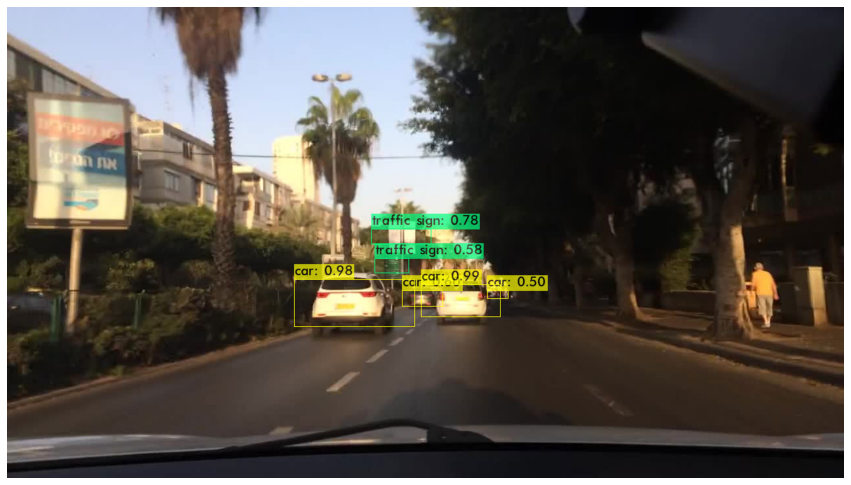

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/*.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

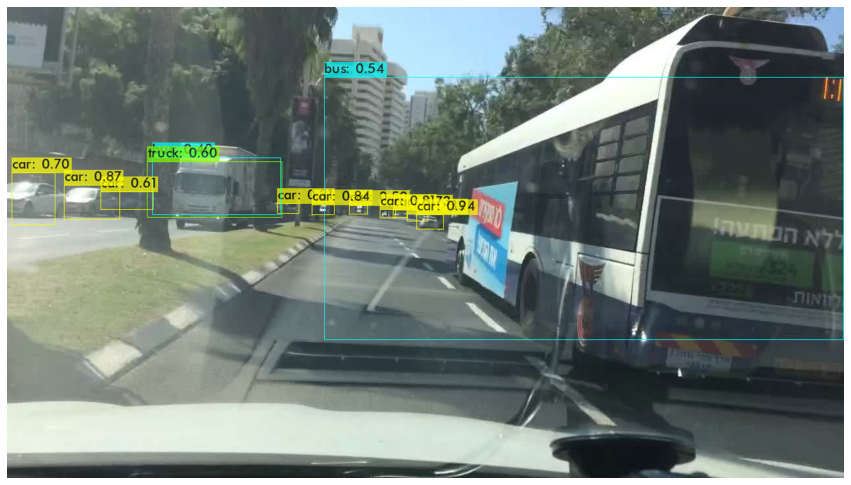

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cabf9f3c-d58a6760.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

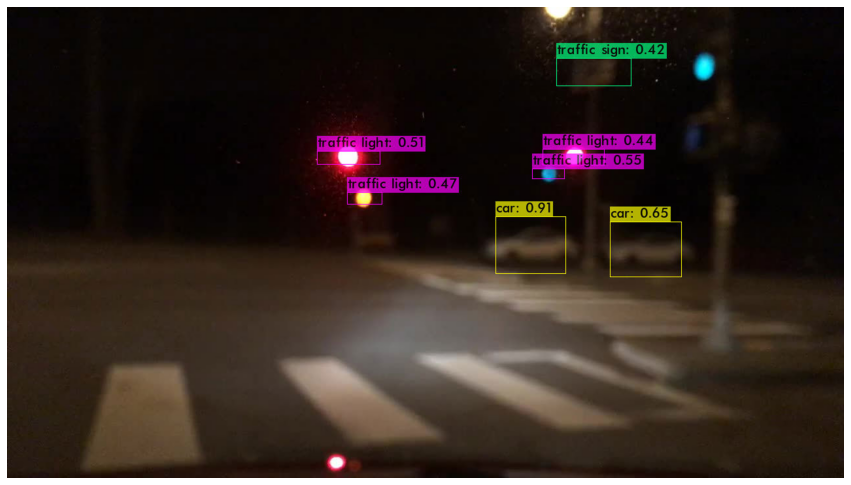

In [ ]:
#cac07407-15b814db.jpg
#cabea010-6882cf41.jpg
#cac07407-76e4c968.jpg
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cac75967-8a9c164b.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

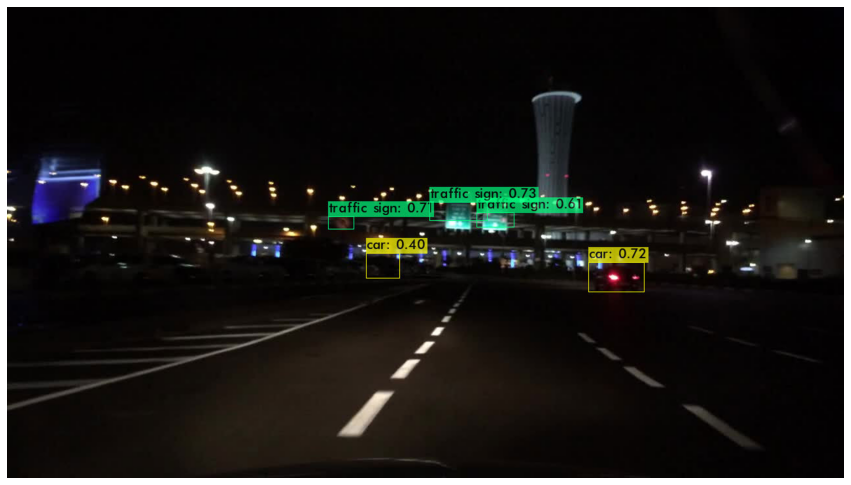

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad54cf7-6779254f.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

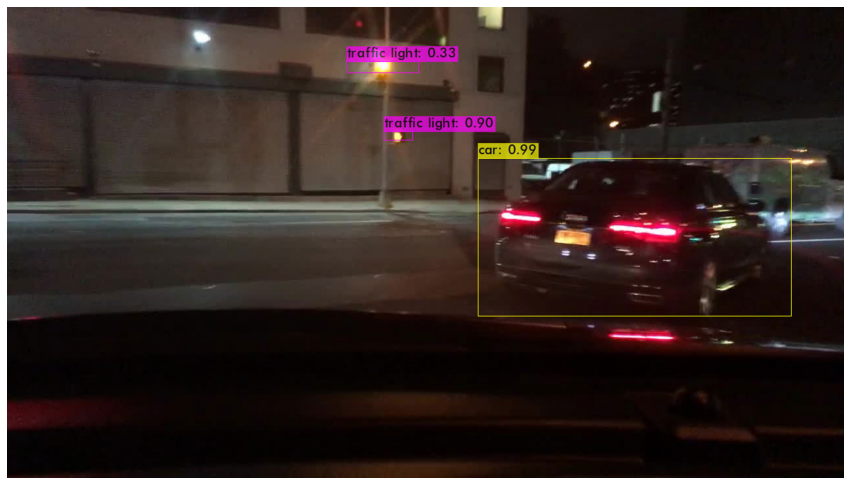

In [ ]:
#cad17389-f72e5365.jpg
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cad17389-f72e5365.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

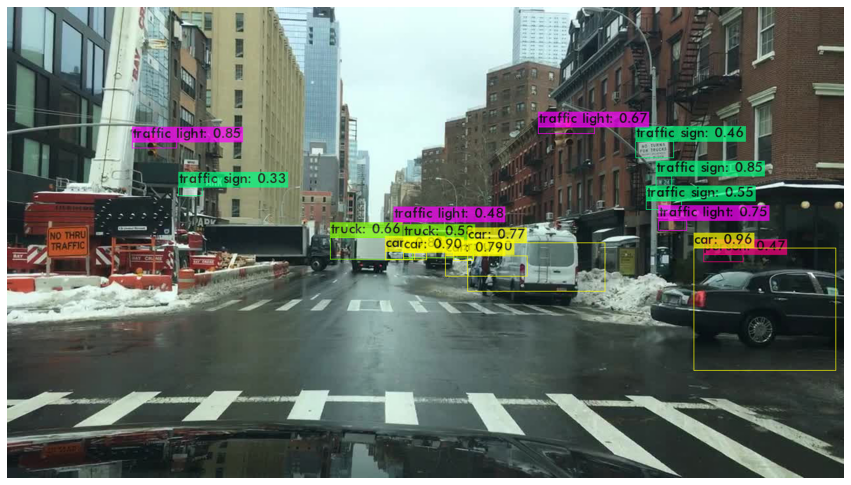

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/cade2aed-db2e9c98.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

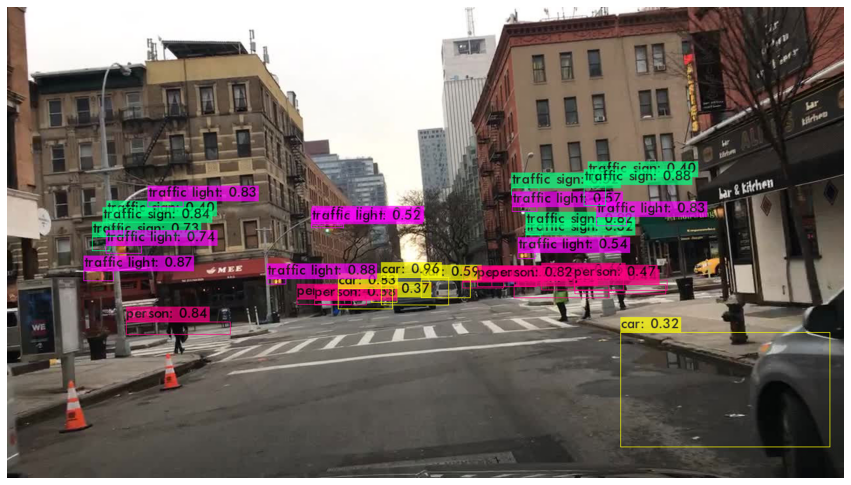

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/caeb0fbb-410c10ca.jpg -thresh 0.3
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104

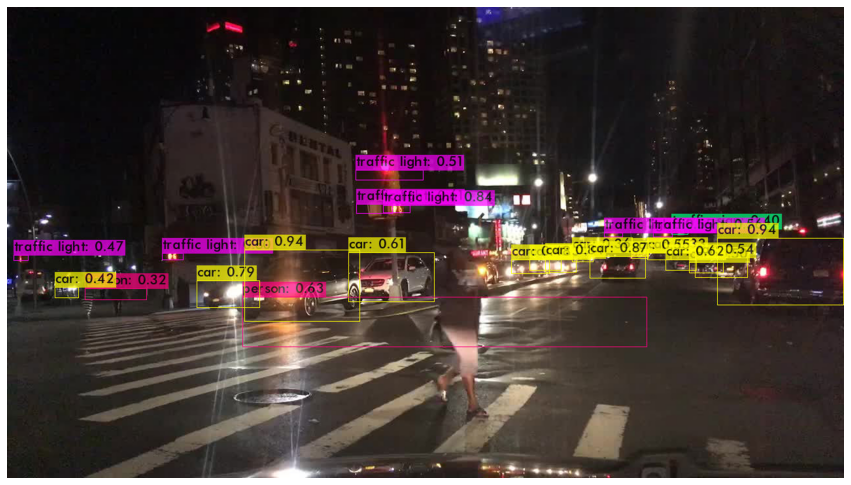

In [ ]:
#caea91fd-e457bf7b.jpg
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/drive/MyDrive/AIMLProject3/bdd100k/images/100k/test/caea91fd-e457bf7b.jpg -thresh 0.3
imShow('predictions.jpg')

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/drive/MyDrive/AIMLProject3/cctv052x2004080516x01638.avi -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_finalresult.avi 

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
Demo
 0 : compute_capability = 600, cudnn_half = 0, GPU: Tesla P100-PCIE-16GB 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/drive/MyDrive/AIMLProject3/cabc30fc-e7726578_46LdT7y6.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_result.avi 

Streaming output truncated to the last 5000 lines.
car: 96% 
car: 91% 
car: 82% 
car: 60% 
car: 50% 
traffic sign: 36% 
traffic light: 94% 
traffic light: 62% 
traffic light: 40% 
traffic light: 39% 
traffic light: 32% 
traffic light: 30% 

FPS:51.7 	 AVG_FPS:41.3

 cvWriteFrame 
Objects:

truck: 86% 
car: 26% , truck: 72% 
truck: 54% 
truck: 44% 
person: 32% 
car: 96% 
car: 91% 
car: 82% 
car: 60% 
car: 50% 
traffic sign: 36% 
traffic light: 94% 
traffic light: 62% 
traffic light: 40% 
traffic light: 39% 
traffic light: 32% 
traffic light: 30% 

FPS:50.3 	 AVG_FPS:41.3

 cvWriteFrame 
Objects:

truck: 86% 
car: 26% , truck: 72% 
truck: 54% 
truck: 44% 
person: 32% 
car: 96% 
car: 91% 
car: 82% 
car: 60% 
car: 50% 
traffic sign: 36% 
traffic light: 94% 
traffic light: 62% 
traffic light: 40% 
traffic light: 39% 
traffic light: 32% 
traffic light: 30% 

FPS:49.3 	 AVG_FPS:41.3

 cvWriteFrame 
Objects:

truck: 86% 
car: 27% , truck: 72% 
truck: 54% 
truck: 44% 
person: 33% 
car: 96% 
car

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/video_sample.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_sample_result.avi 

Streaming output truncated to the last 5000 lines.
car: 59% 
car: 34% 
car: 29% 
traffic sign: 72% 
traffic sign: 61% 
traffic sign: 54% 
traffic sign: 34% 
traffic light: 41% 
traffic light: 37% 

FPS:51.5 	 AVG_FPS:60.7

 cvWriteFrame 
Objects:

person: 58% 
car: 100% 
car: 99% 
car: 99% 
car: 92% 
car: 92% 
car: 92% 
car: 91% 
car: 85% 
car: 83% 
car: 78% 
car: 73% 
car: 65% 
car: 56% 
car: 40% 
car: 35% 
car: 29% 
traffic sign: 69% 
traffic sign: 63% 
traffic sign: 60% 
traffic sign: 31% 
traffic light: 42% 
traffic light: 36% 

FPS:51.6 	 AVG_FPS:60.7

 cvWriteFrame 
Objects:

person: 55% 
car: 100% 
car: 99% 
car: 99% 
car: 93% 
car: 93% 
car: 91% 
car: 90% 
car: 83% 
car: 79% 
car: 78% 
car: 67% 
car: 58% 
car: 57% 
car: 33% 
car: 31% 
car: 30% 
traffic sign: 66% 
traffic sign: 64% 
traffic sign: 56% 
traffic sign: 33% 
traffic light: 41% 
traffic light: 35% 

FPS:51.3 	 AVG_FPS:60.7

 cvWriteFrame 
Objects:

person: 45% 
car: 100% 
car: 99% 
car: 99% 
car: 92% 
car: 92% 
car: 9

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/video_sample2.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_sample_result2.avi 

Streaming output truncated to the last 5000 lines.

FPS:50.6 	 AVG_FPS:47.0

 cvWriteFrame 
Objects:

person: 63% 
person: 26% 
car: 100% 
car: 100% 
car: 97% 
car: 94% 
car: 86% 
car: 86% 
car: 46% 
car: 38% 
traffic sign: 93% 
traffic sign: 65% 
traffic sign: 56% 
traffic sign: 56% 
traffic light: 88% 
traffic light: 77% 
traffic light: 59% 
traffic light: 54% 
traffic light: 45% 

FPS:50.9 	 AVG_FPS:47.0

 cvWriteFrame 
Objects:

person: 60% 
car: 100% 
car: 100% 
car: 99% 
car: 96% 
car: 71% 
car: 66% 
car: 43% 
car: 28% 
traffic sign: 93% 
traffic sign: 65% 
traffic sign: 56% 
traffic sign: 55% 
traffic light: 88% 
traffic light: 76% 
traffic light: 58% 
traffic light: 56% 
traffic light: 46% 

FPS:51.2 	 AVG_FPS:47.0

 cvWriteFrame 
Objects:

person: 27% 
car: 100% 
car: 99% 
car: 99% 
car: 95% 
car: 69% 
car: 56% 
car: 34% 
car: 28% 
traffic sign: 93% 
traffic sign: 68% 
traffic sign: 60% 
traffic sign: 52% 
traffic sign: 42% 
traffic light: 90% 
traffic light: 79% 
traffic ligh

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 750, cudnn_half = 1, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595

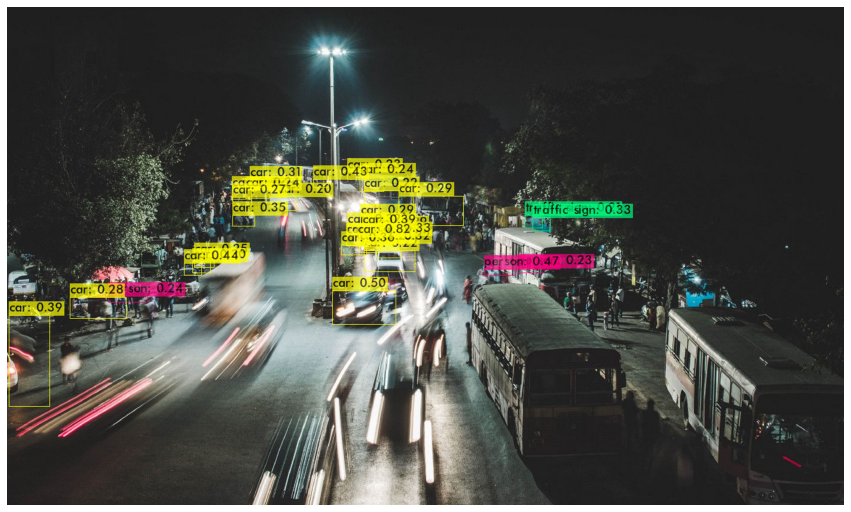

In [ ]:
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/0_GRQ_TWk7WluAKG70.jpg -thresh 0.2
imShow('predictions.jpg')

 CUDA-version: 11010 (11020), cuDNN: 7.6.5, CUDNN_HALF=1, GPU count: 1  
 CUDNN_HALF=1 
 OpenCV version: 3.2.0
 0 : compute_capability = 750, cudnn_half = 1, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 1, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595

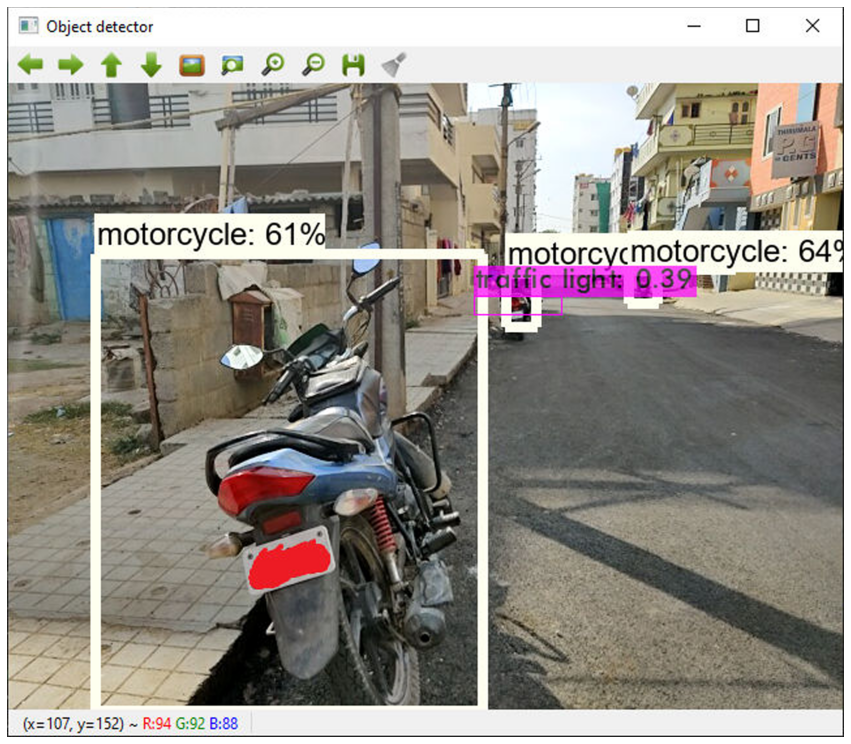

In [ ]:
#caea91fd-e457bf7b.jpg
!./darknet detector test /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg  /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights /content/1_KRs8V1nC8JhhWR80K8EjsQ.png -thresh 0.3
imShow('predictions.jpg')

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/india_traffic.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_sample_result3.avi 

Streaming output truncated to the last 5000 lines.

FPS:28.8 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:29.0 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:29.7 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.1 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:

traffic light: 34% 

FPS:30.1 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.3 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:31.1 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.6 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.3 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.3 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.4 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.8 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:

bike: 32% 

FPS:31.2 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:

bike: 30% 

FPS:30.9 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.3 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.5 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:29.7 	 AVG_FPS:24.9

 cvWriteFrame 
Objects:


FPS:30.0 	 AVG_FPS:24.9

 cvWriteFrame 

In [ ]:
!./darknet detector demo /content/drive/MyDrive/AIMLProject3/yolov3/darknet/data/bdd100k.data  /content/drive/MyDrive/AIMLProject3/yolov3/darknet/cfg/yolov3.cfg   /content/drive/MyDrive/AIMLProject3/yolov3/training/yolov3_final.weights -dont_show /content/traffic_video.mp4 -i 0 -out_filename /content/drive/MyDrive/AIMLProject3/video_sample_result3.avi 

Streaming output truncated to the last 5000 lines.

person: 59% 
person: 51% 
person: 48% 
person: 36% 
person: 36% 
person: 30% 
person: 28% 
person: 26% 
car: 86% 
car: 78% 
car: 72% 
car: 58% 
car: 57% 
car: 56% 
car: 54% 
car: 50% 
car: 49% 
car: 48% 
car: 44% 
car: 42% 
car: 39% 
car: 36% 
car: 36% 
car: 35% 
car: 33% 
car: 27% 
car: 27% 
traffic sign: 52% 

FPS:15.2 	 AVG_FPS:14.5

 cvWriteFrame 
Objects:

person: 52% 
person: 47% 
person: 41% 
person: 38% 
person: 34% 
person: 31% 
person: 28% 
person: 26% 
car: 87% 
car: 72% 
car: 71% 
car: 66% 
car: 60% 
car: 54% 
car: 53% 
car: 46% 
car: 42% 
car: 39% 
car: 38% 
car: 38% 
car: 36% 
car: 31% 
car: 31% 
car: 30% 
car: 30% 
car: 30% 
car: 29% 
car: 28% 
car: 28% 
car: 26% 
traffic sign: 61% 

FPS:14.7 	 AVG_FPS:14.5

 cvWriteFrame 
Objects:

person: 49% 
person: 45% 
person: 43% 
person: 42% 
person: 42% 
person: 32% 
car: 87% 
car: 70% 
car: 68% 
car: 63% 
car: 52% 
car: 52% 
car: 46% 
car: 45% 
car: 45% 
car: 44% 
car: 43% 
ca

In [ ]:
4/1AX4XfWhTDEhbs5iK7W03Zf6dsxdPBShV07c_5CTZS7gayt-hHMdmOrZy56c